In [39]:
from transformers import pipeline
classifier = pipeline("zero-shot-classification",
                      model="facebook/bart-large-mnli")

In [40]:
#Small sample to check proper working of the model
sequence_to_classify = "one day I will see the world"
candidate_labels = ['travel', 'cooking', 'dancing']
classifier(sequence_to_classify, candidate_labels)

{'sequence': 'one day I will see the world',
 'labels': ['travel', 'dancing', 'cooking'],
 'scores': [0.9938650727272034, 0.003273776965215802, 0.0028610636945813894]}

In [41]:
# !pip install wordcloud

# Imports 
from wordcloud import WordCloud, STOPWORDS
import pandas as pd
import matplotlib.pyplot as plt

In [42]:
df = pd.read_csv('ubuntu_customer_msg_small.csv')

In [43]:
text = df['raw_text'].str.cat(sep=' ')

In [44]:
print(text)
len(df)

Hello folks, please help me a bit with the following sentence: 'Order here your personal photos or videos.' - I think the only allowed version is 'Order your personal videos or photos here.', but I'm not sure, are you? is there any reason why my 'network manager' icon in my tray does not scale when the other ones get resized when i change the size of the panel? I installed the 64bit version of ubuntu and I can't open firefox(segfault) and if I try to open nautilus nothing happens and my cpu goes 100%, what can I do??? Hello Does Ubuntu have somekind of register to configure applications and os settings? anyone else run into issues with cd/dvd burners not identifying blank media installed? Where does synoptic install the programs to? Like it aint on desktop are there any utils that will do a repair of your laptop once in a while ? hi folks, i'm making a backup of my root partition just incase this gparted livecd resize goes wrong - at the moment i am just cp -Rp /bin /etc /lib /sbin /us

185762

In [45]:
stopwords= set(STOPWORDS)
#Remove words that are not useful
new_words = ['got', 'good', 'know', 'problem', 'now','guy','apt','someone','says','im','use', 'run', 'hey', 'see','using','will', 'work', 'trying', 'one', 'say', 'hi', 'seem', 'ok', 'okay', 'thank', 'thanks', 'hello', 'yes', 'sure', 'like', 'want', 'need', 'help', 'try']
new_stopwords= stopwords.union(new_words)

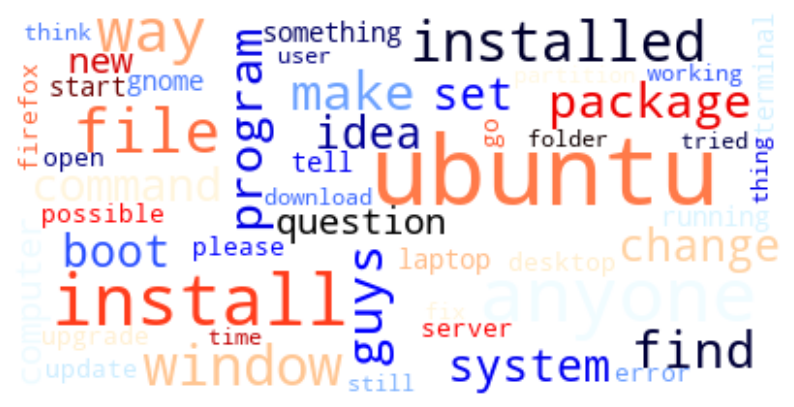

In [46]:
plt.rcParams['figure.figsize'] = (10, 10)
wordcloud = WordCloud(max_font_size=50, max_words=50, background_color="white", stopwords=new_stopwords, colormap='flag').generate(text) #generate word cloud to find probable labels
plt.plot()
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis('off')
plt.show()

In [47]:
from tqdm import tqdm

labels= ['linux', 'window','program','install','system','file','server','package','command','kernel','version','error','boot','update','network','driver','terminal', 'package', 'firefox']
predictedCategories = []
predicted = []
length = len(df) #length of the dataframe
# print(length)
for i in tqdm(range(10)):
    text = df.iloc[i,]['raw_text']
    print(text)
    res = classifier(text, labels, multi_class=True) # multi-class as True
    labels = res['labels'] 
    scores = res['scores'] #get scores associated with the labels
    res_dict = {label : score for label,score in zip(labels, scores)}
    print(res_dict)
    sorted_dict = dict(sorted(res_dict.items(), key=lambda x:x[1],reverse = True)) #sort dictionary of labels in descending order of score
    categories  = []
    for i, n in enumerate(sorted_dict.items()):
        if(i > 2): #fetching best 3 predictions
            break
        else:
            categories.append(n)
    predictedCategories.append(categories)

  0%|          | 0/10 [00:00<?, ?it/s]The `multi_class` argument has been deprecated and renamed to `multi_label`. `multi_class` will be removed in a future version of Transformers.


Hello folks, please help me a bit with the following sentence: 'Order here your personal photos or videos.' - I think the only allowed version is 'Order your personal videos or photos here.', but I'm not sure, are you?


 10%|█         | 1/10 [00:05<00:53,  5.96s/it]The `multi_class` argument has been deprecated and renamed to `multi_label`. `multi_class` will be removed in a future version of Transformers.


{'system': 0.8734412789344788, 'server': 0.8305463790893555, 'version': 0.8112015724182129, 'program': 0.7160395383834839, 'command': 0.6912204027175903, 'network': 0.6173598170280457, 'update': 0.5862752199172974, 'file': 0.5824593305587769, 'package': 0.5356457829475403, 'window': 0.5277038812637329, 'error': 0.4958164393901825, 'install': 0.41763508319854736, 'driver': 0.4047076404094696, 'boot': 0.34378087520599365, 'linux': 0.2819563150405884, 'kernel': 0.2250692993402481, 'firefox': 0.20232215523719788, 'terminal': 0.03449561446905136}
is there any reason why my 'network manager' icon in my tray does not scale when the other ones get resized when i change the size of the panel?


 20%|██        | 2/10 [00:11<00:46,  5.78s/it]The `multi_class` argument has been deprecated and renamed to `multi_label`. `multi_class` will be removed in a future version of Transformers.


{'network': 0.9749138355255127, 'version': 0.686532199382782, 'program': 0.5958167314529419, 'system': 0.5599531531333923, 'update': 0.4898248016834259, 'boot': 0.4505898654460907, 'window': 0.42356428503990173, 'linux': 0.32833072543144226, 'error': 0.30011191964149475, 'install': 0.20699165761470795, 'file': 0.11750935763120651, 'package': 0.09176570922136307, 'command': 0.08090229332447052, 'firefox': 0.030535880476236343, 'terminal': 0.019234905019402504, 'server': 0.0028129417914897203, 'driver': 0.002621420891955495, 'kernel': 0.002458240371197462}
I installed the 64bit version of ubuntu and I can't open firefox(segfault) and if I try to open nautilus nothing happens and my cpu goes 100%, what can I do???


 30%|███       | 3/10 [00:18<00:42,  6.12s/it]The `multi_class` argument has been deprecated and renamed to `multi_label`. `multi_class` will be removed in a future version of Transformers.


{'error': 0.9179199934005737, 'firefox': 0.9097211956977844, 'install': 0.8871573805809021, 'version': 0.8586058020591736, 'system': 0.8547907471656799, 'linux': 0.7953716516494751, 'program': 0.7692470550537109, 'package': 0.5412949919700623, 'command': 0.5132924318313599, 'file': 0.3645287752151489, 'update': 0.3140300512313843, 'boot': 0.08432559669017792, 'driver': 0.06802448630332947, 'server': 0.06355264037847519, 'terminal': 0.02836115099489689, 'network': 0.02577255107462406, 'window': 0.018230020999908447, 'kernel': 0.0012794614303857088}
Hello Does Ubuntu have somekind of register to configure applications and os settings?


 40%|████      | 4/10 [00:22<00:32,  5.44s/it]The `multi_class` argument has been deprecated and renamed to `multi_label`. `multi_class` will be removed in a future version of Transformers.


{'system': 0.7135335803031921, 'version': 0.5839400291442871, 'window': 0.47446930408477783, 'server': 0.4448469579219818, 'file': 0.39401036500930786, 'package': 0.3932345509529114, 'program': 0.3185090720653534, 'terminal': 0.2629286050796509, 'linux': 0.2280265837907791, 'driver': 0.20670190453529358, 'update': 0.19053302705287933, 'boot': 0.17898426949977875, 'install': 0.17048001289367676, 'command': 0.16100101172924042, 'firefox': 0.13994161784648895, 'network': 0.09607739001512527, 'kernel': 0.02964051440358162, 'error': 0.009154971688985825}
anyone else run into issues with cd/dvd burners not identifying blank media installed?


 50%|█████     | 5/10 [00:27<00:25,  5.11s/it]The `multi_class` argument has been deprecated and renamed to `multi_label`. `multi_class` will be removed in a future version of Transformers.


{'system': 0.7133808135986328, 'version': 0.6585168242454529, 'error': 0.6353051066398621, 'install': 0.605575680732727, 'package': 0.5526676774024963, 'program': 0.5125613212585449, 'server': 0.45156940817832947, 'driver': 0.4078380763530731, 'file': 0.38397741317749023, 'boot': 0.3698195219039917, 'command': 0.3619740903377533, 'window': 0.24370527267456055, 'update': 0.20244961977005005, 'network': 0.17705892026424408, 'linux': 0.1435254067182541, 'kernel': 0.1370174139738083, 'terminal': 0.07729627937078476, 'firefox': 0.049593690782785416}
Where does synoptic install the programs to? Like it aint on desktop


 60%|██████    | 6/10 [00:31<00:19,  4.92s/it]The `multi_class` argument has been deprecated and renamed to `multi_label`. `multi_class` will be removed in a future version of Transformers.


{'program': 0.6999816298484802, 'install': 0.6109616756439209, 'version': 0.5360584259033203, 'driver': 0.39138418436050415, 'system': 0.3805810213088989, 'update': 0.37875378131866455, 'package': 0.3683628439903259, 'command': 0.34976232051849365, 'error': 0.3297751545906067, 'file': 0.26050493121147156, 'firefox': 0.15955209732055664, 'kernel': 0.14528806507587433, 'boot': 0.1328263133764267, 'window': 0.1247379407286644, 'terminal': 0.1042880266904831, 'linux': 0.08238916844129562, 'network': 0.07108213752508163, 'server': 0.04993885010480881}
are there any utils that will do a repair of your laptop once in a while ?


 70%|███████   | 7/10 [00:36<00:14,  4.82s/it]The `multi_class` argument has been deprecated and renamed to `multi_label`. `multi_class` will be removed in a future version of Transformers.


{'system': 0.6111302971839905, 'version': 0.5386608839035034, 'file': 0.4131018817424774, 'boot': 0.3318399488925934, 'linux': 0.3082233667373657, 'driver': 0.26913386583328247, 'update': 0.2591051757335663, 'firefox': 0.22862814366817474, 'command': 0.2273973673582077, 'program': 0.13941486179828644, 'install': 0.11163004487752914, 'package': 0.10801395028829575, 'kernel': 0.08083638548851013, 'error': 0.0667620599269867, 'network': 0.020750008523464203, 'window': 0.013693033717572689, 'terminal': 0.009245434775948524, 'server': 0.009221247397363186}
hi folks, i'm making a backup of my root partition just incase this gparted livecd resize goes wrong - at the moment i am just cp -Rp /bin /etc /lib /sbin /usr /boot /home /opt /srv /var /vmlinuz /media /opt /root  -- is there anything else i should be doing?


 80%|████████  | 8/10 [00:43<00:11,  5.69s/it]The `multi_class` argument has been deprecated and renamed to `multi_label`. `multi_class` will be removed in a future version of Transformers.


{'command': 0.7787514925003052, 'system': 0.7767728567123413, 'version': 0.7598983645439148, 'program': 0.6931696534156799, 'terminal': 0.6693859100341797, 'boot': 0.6441504955291748, 'file': 0.6222593188285828, 'linux': 0.5933358073234558, 'update': 0.589603841304779, 'package': 0.5147522687911987, 'window': 0.4562391936779022, 'install': 0.3657970130443573, 'kernel': 0.2974218428134918, 'server': 0.2367246299982071, 'error': 0.23155507445335388, 'network': 0.2163606584072113, 'driver': 0.14846867322921753, 'firefox': 0.07351373136043549}
is there a way to tell ubuntu not to show icon for a specific external hdd on the desktop? (but i want others to show up on the desktop)


 90%|█████████ | 9/10 [00:50<00:05,  5.97s/it]The `multi_class` argument has been deprecated and renamed to `multi_label`. `multi_class` will be removed in a future version of Transformers.


{'driver': 0.8288418054580688, 'network': 0.6426541209220886, 'system': 0.5964507460594177, 'kernel': 0.5842642784118652, 'version': 0.538856565952301, 'server': 0.5126047730445862, 'program': 0.4984213411808014, 'package': 0.38135793805122375, 'install': 0.38105636835098267, 'window': 0.3049089014530182, 'file': 0.25229302048683167, 'terminal': 0.23227621614933014, 'update': 0.229681596159935, 'linux': 0.18891647458076477, 'boot': 0.14678959548473358, 'command': 0.1275232881307602, 'error': 0.1242758259177208, 'firefox': 0.07171827554702759}
Is there a second cd needed for the 9.04 beta server install? I keep reaching about 77% completed and then it asks for 'Ubuntu-Server 9.04 _Jaunty Jackalope_ Beta i386 (20090324.2)'


100%|██████████| 10/10 [00:57<00:00,  5.77s/it]

{'server': 0.9376651644706726, 'system': 0.9196035265922546, 'program': 0.8279477953910828, 'version': 0.7826918959617615, 'file': 0.7445905804634094, 'command': 0.7254942059516907, 'terminal': 0.6918251514434814, 'package': 0.6771957278251648, 'linux': 0.6714282631874084, 'window': 0.6656823754310608, 'install': 0.6637720465660095, 'update': 0.6636285781860352, 'error': 0.5539610385894775, 'network': 0.47145459055900574, 'boot': 0.43739038705825806, 'driver': 0.34768956899642944, 'kernel': 0.12799754738807678, 'firefox': 0.018444795161485672}


In [48]:
for txt, y_pred in zip(df.raw_text[:10],predictedCategories[:10]):
    print(f'Query {txt}')
    print(f'Predicted Categories {y_pred}')
    print('#'*50)

Query Hello folks, please help me a bit with the following sentence: 'Order here your personal photos or videos.' - I think the only allowed version is 'Order your personal videos or photos here.', but I'm not sure, are you?
Predicted Categories [('system', 0.8734412789344788), ('server', 0.8305463790893555), ('version', 0.8112015724182129)]
##################################################
Query is there any reason why my 'network manager' icon in my tray does not scale when the other ones get resized when i change the size of the panel?
Predicted Categories [('network', 0.9749138355255127), ('version', 0.686532199382782), ('program', 0.5958167314529419)]
##################################################
Query I installed the 64bit version of ubuntu and I can't open firefox(segfault) and if I try to open nautilus nothing happens and my cpu goes 100%, what can I do???
Predicted Categories [('error', 0.9179199934005737), ('firefox', 0.9097211956977844), ('install', 0.8871573805809021)